In [25]:
import os
import json

import cv2
from PIL import Image, ImageDraw, ImageFilter
import numpy as np
import matplotlib.pyplot as plt

from shapely.geometry import Polygon
from shapely import wkt

%matplotlib inline

In [9]:
imgs_dir = os.path.join('data', 'horses')
sam_output_dir = os.path.join('outputs', '20231230201732')

list_jsonfiles = os.listdir(sam_output_dir)
print('list_jsonfiles:', len(list_jsonfiles))

list_jsonfiles: 189


/home/pyml/git/auto-image-labeling/subset2/n02381460_2276.jpg
(30.0, 16.0, 245.0, 236.0)
(47.0, 182.0, 53.0, 217.0)
(73.0, 175.0, 74.0, 183.0)
(78.0, 126.0, 81.0, 131.0)
(38.0, 122.0, 41.0, 131.0)
(107.0, 118.0, 112.0, 128.0)
(103.0, 118.0, 106.0, 129.0)
(91.0, 118.0, 93.0, 125.0)
(87.0, 118.0, 90.0, 125.0)
(83.0, 118.0, 85.0, 124.0)
(39.0, 118.0, 41.0, 121.0)
(35.0, 114.0, 38.0, 124.0)
(30.0, 19.0, 246.0, 232.0)


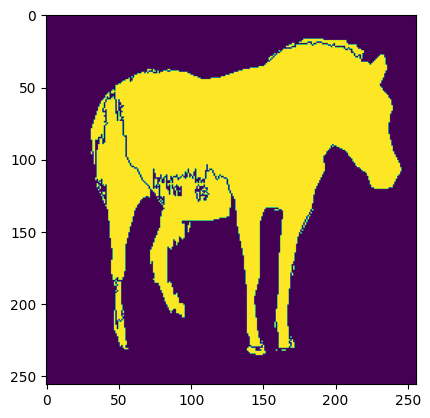

In [30]:
for filename in list_jsonfiles:
    path = os.path.join(sam_output_dir, filename)
    with open(path, 'rt') as fp:
        d_json = json.load(fp)
    print(d_json['image_path'])
    #print(d_json['polygons'])

    filename_jpg = os.path.basename(d_json['image_path'])
    path_jpg = os.path.join(imgs_dir, filename_jpg)
    img = Image.open(path_jpg)
    mask = Image.new('L', (img.width, img.height), 0)

    int_polygons = []
    for polygon_str in d_json['polygons']:
        polygon = wkt.loads(polygon_str)
        print(polygon.bounds)
        coords = polygon.exterior.coords
        minx, miny, maxx, maxy = polygon.bounds
        draw = ImageDraw.Draw(mask)

        #offset_coords = [(x - minx, y - miny) for x, y in coords]
        
        # Draw the polygon (255 is white, filling in the polygon)
        draw.polygon(list(coords), outline=1, fill=255)

    break
plt.imshow(mask)

### Closing with PIL.ImageFilter

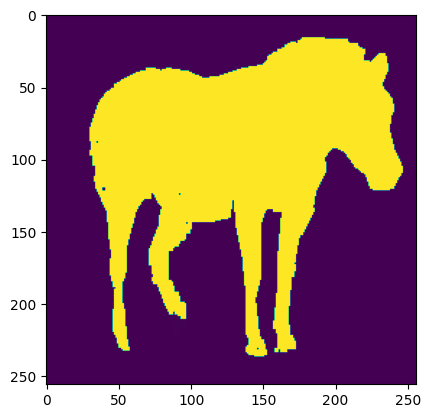

In [34]:
from PIL import ImageFilter
dilated_mask = mask.filter(ImageFilter.MaxFilter(3))

plt.imshow(dilated_mask)

### Closing with OpenCV's morphologyEx

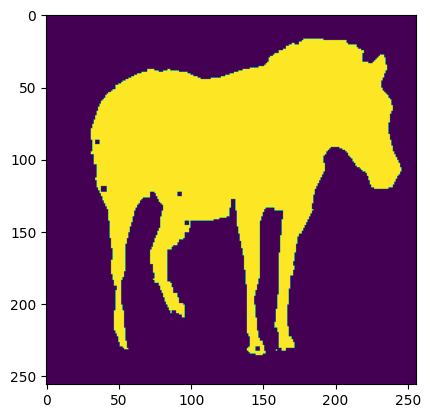

In [35]:
import cv2
import numpy as np

mask_array = np.array(mask)

kernel = np.ones((3,3),np.uint8)

# Apply closing operation
closing = cv2.morphologyEx(mask_array, cv2.MORPH_CLOSE, kernel)

# Convert back to PIL image and show or save
result_mask = Image.fromarray(closing)
plt.imshow(result_mask)

/home/pyml/git/auto-image-labeling/subset2/n02381460_2276.jpg
(30.0, 16.0, 245.0, 236.0)
(47.0, 182.0, 53.0, 217.0)
(73.0, 175.0, 74.0, 183.0)
(78.0, 126.0, 81.0, 131.0)
(38.0, 122.0, 41.0, 131.0)
(107.0, 118.0, 112.0, 128.0)
(103.0, 118.0, 106.0, 129.0)
(91.0, 118.0, 93.0, 125.0)
(87.0, 118.0, 90.0, 125.0)
(83.0, 118.0, 85.0, 124.0)
(39.0, 118.0, 41.0, 121.0)
(35.0, 114.0, 38.0, 124.0)
(30.0, 19.0, 246.0, 232.0)


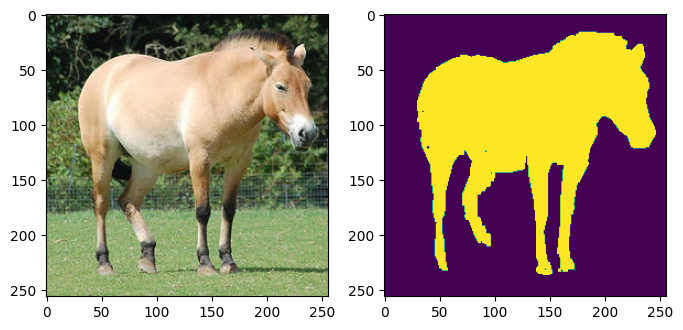

In [37]:
for filename in list_jsonfiles:
    path = os.path.join(sam_output_dir, filename)
    with open(path, 'rt') as fp:
        d_json = json.load(fp)

    filename_jpg = os.path.basename(d_json['image_path'])
    path_jpg = os.path.join(imgs_dir, filename_jpg)
    img = Image.open(path_jpg)
    mask = Image.new('L', (img.width, img.height), 0)

    int_polygons = []
    for polygon_str in d_json['polygons']:
        polygon = wkt.loads(polygon_str)
        coords = polygon.exterior.coords
        minx, miny, maxx, maxy = polygon.bounds
        draw = ImageDraw.Draw(mask)

        draw.polygon(list(coords), outline=1, fill=255)

    dilated_mask = mask.filter(ImageFilter.MaxFilter(3))

    break

fig, axes = plt.subplots(1, 2, figsize=(8, 15))
axes[0].imshow(img)
axes[1].imshow(dilated_mask)

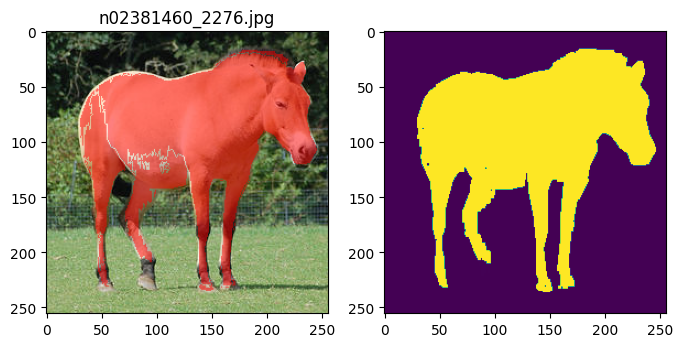

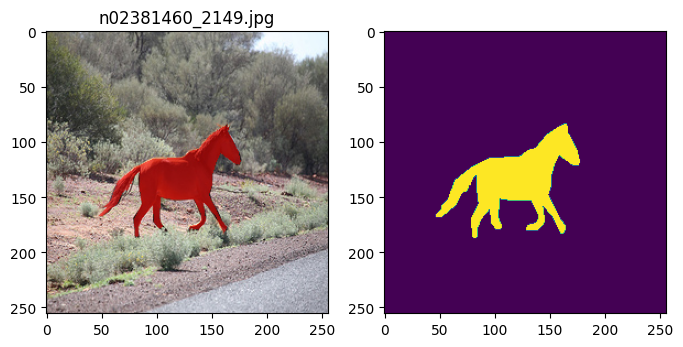

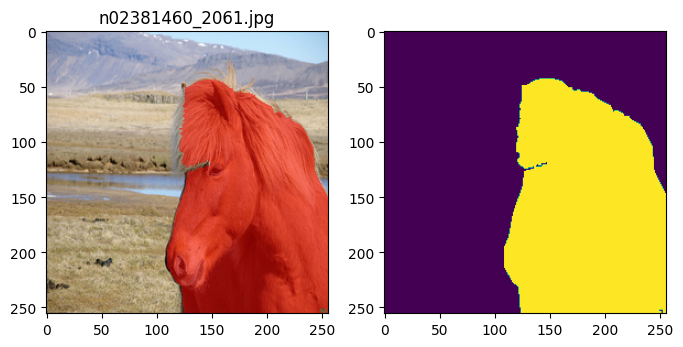

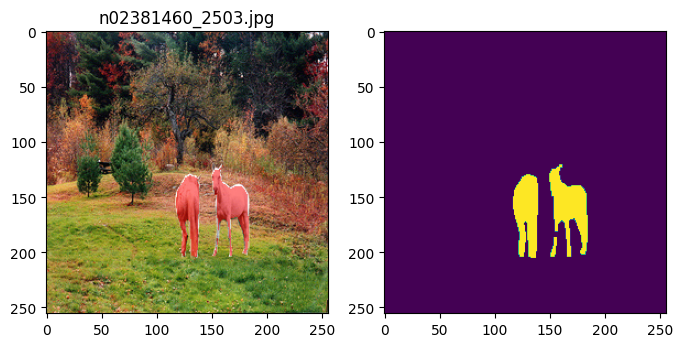

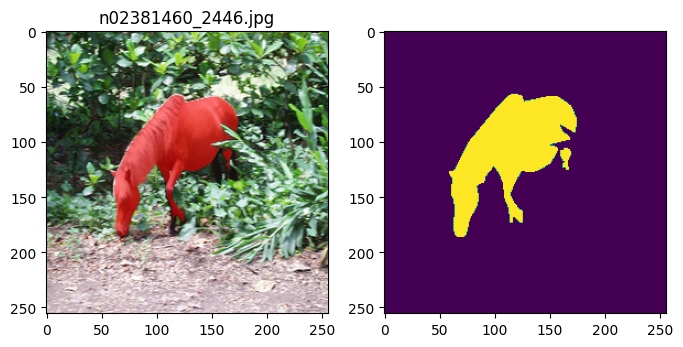

...

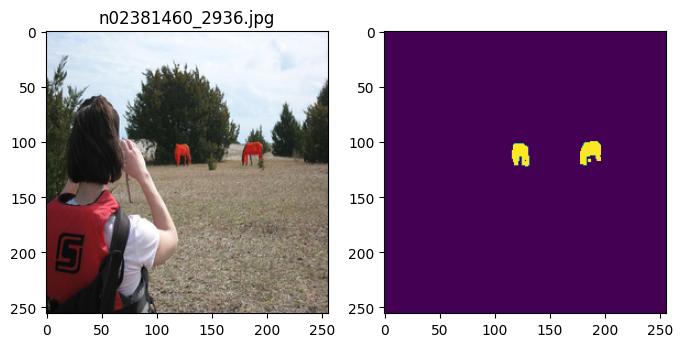

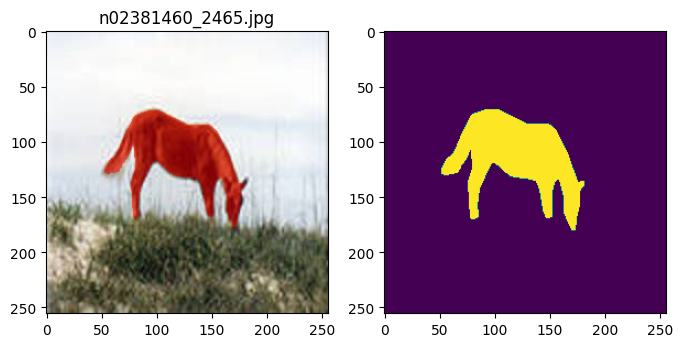

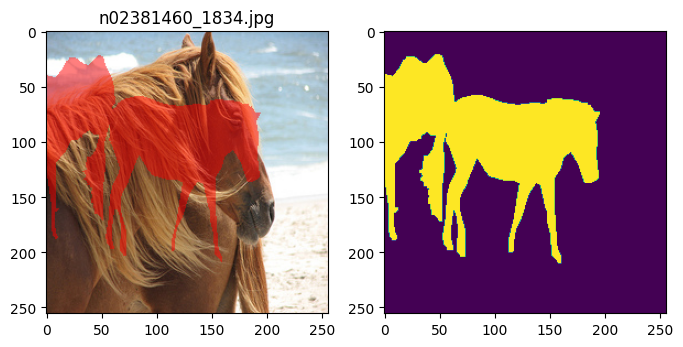

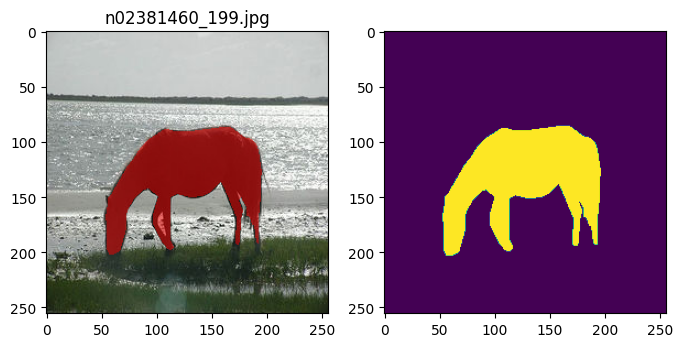

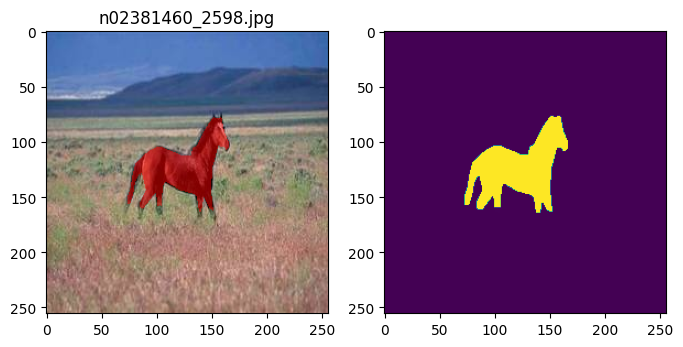

In [50]:
import random

output_mask_dir = os.path.join('outputs', 'masks')
os.makedirs(output_mask_dir, exist_ok=True)

for filename in list_jsonfiles:
    path = os.path.join(sam_output_dir, filename)
    with open(path, 'rt') as fp:
        d_json = json.load(fp)

    filename_jpg = os.path.basename(d_json['image_path'])
    path_jpg = os.path.join(imgs_dir, filename_jpg)
    img = Image.open(path_jpg)
    mask = Image.new('L', (img.width, img.height), 0)
    img_rgba = img.convert('RGBA')
    #img_draw = ImageDraw.Draw(img_rgba)
    overlay = Image.new('RGBA', img.size, (255,255,255,0))
    overlay_draw = ImageDraw.Draw(overlay)
    mask_draw = ImageDraw.Draw(mask)

    int_polygons = []
    for polygon_str in d_json['polygons']:
        polygon = wkt.loads(polygon_str)
        coords = polygon.exterior.coords
        minx, miny, maxx, maxy = polygon.bounds
        #img_draw.polygon(list(coords), outline=1, fill=(255, 0, 0, 128))
        overlay_draw.polygon(list(coords), outline=1, fill=(255, 0, 0, 128))
        mask_draw.polygon(list(coords), outline=1, fill=255)

    dilated_mask = mask.filter(ImageFilter.MaxFilter(3))

    output_mask_path = os.path.join(output_mask_dir, filename_jpg[:-4] + '.png')
    dilated_mask.save(output_mask_path)

    combined_with_overlay = Image.alpha_composite(img_rgba, overlay)

    # show some random samples
    if True: #random.random() > 0.9:
        fig, axes = plt.subplots(1, 2, figsize=(8, 15))
        axes[0].set_title(filename_jpg)
        #axes[0].imshow(img_rgba)
        axes[0].imshow(combined_with_overlay)
        axes[1].imshow(dilated_mask)
        plt.show()

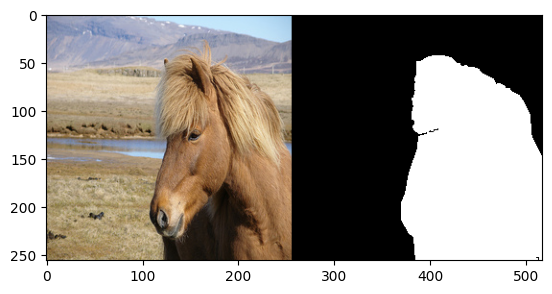

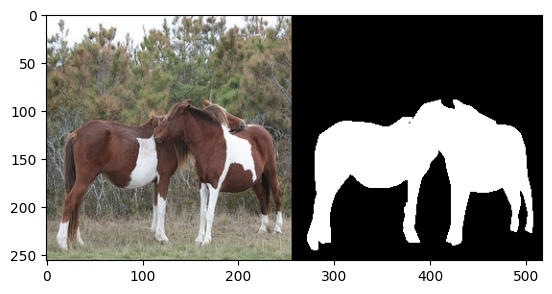

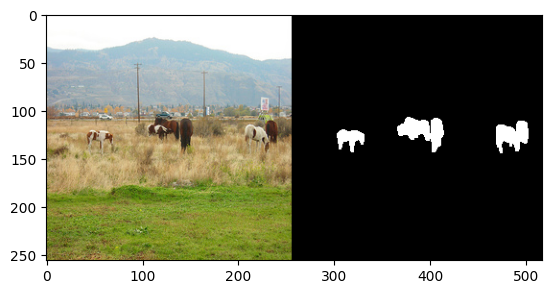

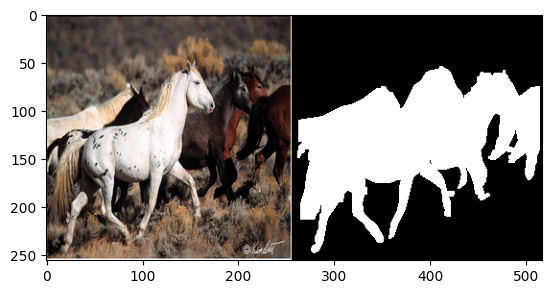

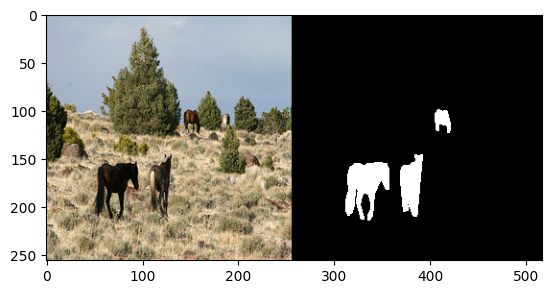

...

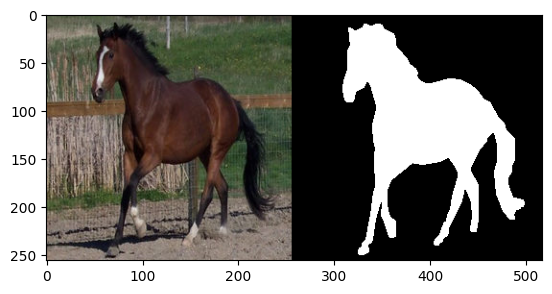

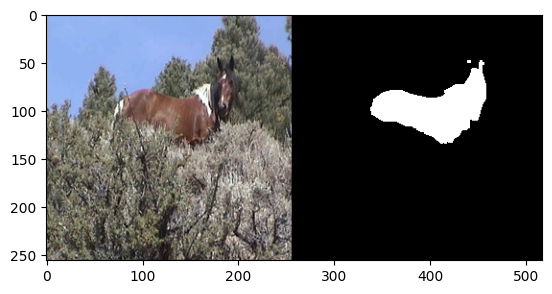

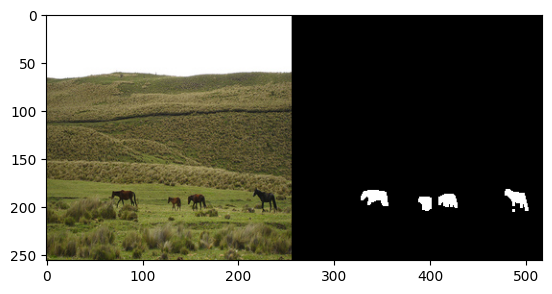

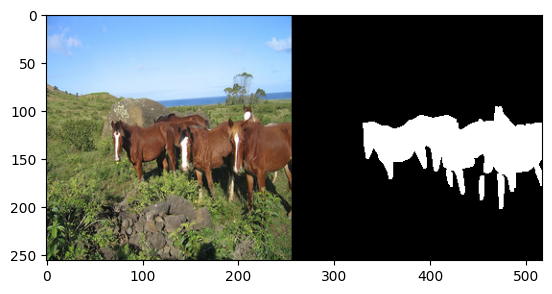

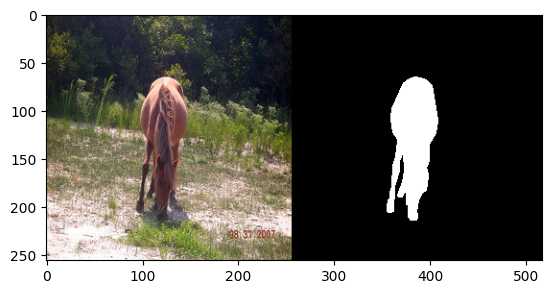

In [41]:
import random

output_mask_dir = os.path.join('outputs', 'masks')
output_imgmask_dir = os.path.join('outputs', 'img-mask')
os.makedirs(output_mask_dir, exist_ok=True)
os.makedirs(output_imgmask_dir, exist_ok=True)

for filename in list_jsonfiles:
    path = os.path.join(sam_output_dir, filename)
    with open(path, 'rt') as fp:
        d_json = json.load(fp)

    filename_jpg = os.path.basename(d_json['image_path'])
    path_jpg = os.path.join(imgs_dir, filename_jpg)
    img = Image.open(path_jpg)
    mask = Image.new('L', (img.width, img.height), 0)

    int_polygons = []
    for polygon_str in d_json['polygons']:
        polygon = wkt.loads(polygon_str)
        coords = polygon.exterior.coords
        minx, miny, maxx, maxy = polygon.bounds
        draw = ImageDraw.Draw(mask)

        draw.polygon(list(coords), outline=1, fill=255)

    dilated_mask = mask.filter(ImageFilter.MaxFilter(3))

    output_mask_path = os.path.join(output_mask_dir, filename_jpg[:-4] + '.png')
    dilated_mask.save(output_mask_path)

    new_width = img.width * 2 + 5
    combined_img = Image.new('RGB', (new_width, img.height))
    combined_img.paste(img, (0, 0))
    combined_img.paste(dilated_mask, (img.width + 5, 0))
    
    output_imgmask_path = os.path.join(output_imgmask_dir, filename_jpg)
    combined_img.save(output_imgmask_path)

    # show some random samples
    if random.random() > 0.9:
        plt.imshow(combined_img)
        plt.show()